# Project Context Summary

Black aphids (Ba) are a major pest in greenhouse crop production, where early detection is essential to prevent rapid population growth and yield loss. In greenhouse monitoring, yellow sticky traps are commonly used to capture flying and crawling insects; however, manual inspection of these traps is time-consuming and prone to human error, especially under high pest density. 

Automated insect detection has been increasingly explored to support integrated pest management (IPM) in greenhouse systems. Previous studies have demonstrated the feasibility of detecting aphids on sticky traps using deep learning–based object detection models, enabling population monitoring and early pest warning systems.

This project builds upon prior research in AI-driven insect detection in greenhouses, particularly the work of Kapetas et al. (2025), who investigated real-time insect detection and population forecasting using YOLO-based approaches. While earlier studies employed YOLOv5, YOLOv8, or YOLOv10 architectures, this project explores the use of a newer YOLO version (YOLO11s) as a technical extension for practice and comparison purposes.

# 1. Environment Setup - Roboflow Installation

In [1]:
!pip install roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 39.4 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 59.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 104.5 MB/s eta 0:00:0000:01
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.12.0.88
    Uninstalling opencv-python-headless-4.12.0.88:
      Successfully uninstalled opencv-python-headless-4.12.0.88
  Attempting uninstall: idna
    Found existing installation: idna 3.11
    Uninstalling idna-3.11:
      Successfully uninstalled idna-3.11
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 2.26.0 requires google-cloud-bigquery-st

# 2. Data Acquisition - Download Dataset

In [2]:
# Download Dataset from Roboflow

from roboflow import Roboflow

rf = Roboflow(api_key="RXgLOb0Ltupsvk0t2a3a")
project = rf.workspace("ilham-klogd").project("insects-uampg")
version = project.version(1)
dataset = version.download("yolov11")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Insects-1 in yolov11:: 100%|██████████| 449/449 [00:00<00:00, 5116.37it/s]


# 3. Environment Setup - Ultralytics

In [3]:
# 1. Ultralytics Installation
!uv pip install ultralytics

Using Python 3.12.12 environment at: /usr
Resolved 49 packages in 135ms                                        
Prepared 2 packages in 59ms                                              
Installed 2 packages in 11ms                                
 + ultralytics==8.3.240
 + ultralytics-thop==2.0.18


In [4]:
# 2. Import library
import os
import glob
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
from ultralytics import YOLO
from IPython.display import display, Image as IPImage

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# 4. Model Training- Yolo11s

In [5]:
model = YOLO("yolo11s.pt")

model.train(
    data="/kaggle/working/Insects-1/data.yaml",
    epochs=200,
    imgsz=1600,          
    batch=4,
    patience=60,
    mosaic=0.0,          
    mixup=0.0,
    hsv_h=0.015,
    hsv_s=0.5,
    hsv_v=0.3,
    device=0,
    workers=2,
)


Ultralytics 8.3.240 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=4, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/Insects-1/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=200, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.5, hsv_v=0.3, imgsz=1600, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11s.pt, momentum=0.937, mosaic=0.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=60, perspective=0.0, pl

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a4d2832ef90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

# 5. Model Evaluation

In [6]:
# 1. Load the best weights from the baseline training

model = YOLO('/kaggle/working/runs/detect/train/weights/best.pt')

# 2. Run validation to get the P, R, and mAP metrics
metrics = model.val(
    data="/kaggle/working/Insects-1/data.yaml",
    imgsz=1600,
    batch=4,
    conf=0.001
)



Ultralytics 8.3.240 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLO11s summary (fused): 100 layers, 9,413,187 parameters, 0 gradients, 21.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1695.2±935.2 MB/s, size: 143.1 KB)
val: Scanning /kaggle/working/Insects-1/valid/labels.cache... 45 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 45/45 93.4Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 12/12 7.0it/s 1.7s0.2s
                   all         45       2484      0.862      0.876      0.896      0.367
Speed: 6.2ms preprocess, 18.4ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to /kaggle/working/runs/detect/val


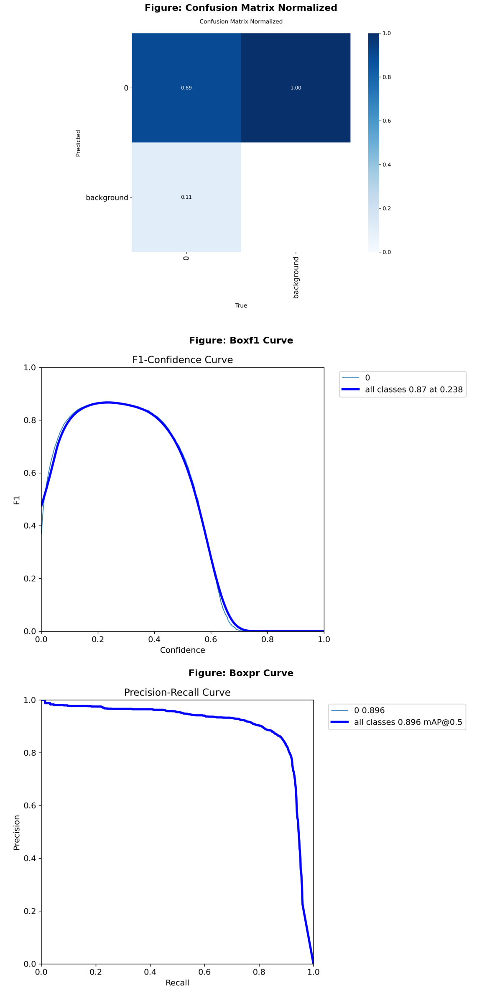

In [7]:
# Define the val directory
results_dirV = '/kaggle/working/runs/detect/val'

# List of essential plots for the Scientific Paper
plots = ['confusion_matrix_normalized.png', 'BoxF1_curve.png', 'BoxPR_curve.png']

# We set the number of rows to the number of plots, and columns to 1
n_plots = len(plots)
plt.figure(figsize=(12, 8 * n_plots)) # Large height to fit all 4 vertically

for i, plot_file in enumerate(plots):
    img_path = os.path.join(results_dirV, plot_file)
    
    if os.path.exists(img_path):
        plt.subplot(n_plots, 1, i + 1)
        img = mpimg.imread(img_path)
        plt.imshow(img)
        plt.axis('off')
        
        # Clean title for English Publication
        clean_title = plot_file.replace('.png', '').replace('_', ' ').title()
        plt.title(f"Figure: {clean_title}", fontsize=16, fontweight='bold')
    else:
        print(f"Warning: {plot_file} not found in {results_dirV}")

plt.tight_layout()
plt.show()

# 6. Inference & Visualization

In [8]:
# Drawing Ground Truth 

def draw_gt(image, label_path, class_name="Ba"):
    h, w, _ = image.shape

    if not os.path.exists(label_path):
        return image

    with open(label_path, 'r') as f:
        lines = f.readlines()

    for line in lines:
        cls, xc, yc, bw, bh = map(float, line.split())

        x1 = int((xc - bw / 2) * w)
        y1 = int((yc - bh / 2) * h)
        x2 = int((xc + bw / 2) * w)
        y2 = int((yc + bh / 2) * h)

        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(
            image, class_name, (x1, y1 - 5),
            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2
        )

    return image


In [9]:
# Load model & Inference

model = YOLO('/kaggle/working/runs/detect/train/weights/best.pt')
model.model.names = {0: "Ba"}

results = model.predict(
    source='/kaggle/working/Insects-1/valid/images',
    imgsz=1600,
    conf=0.238, #from F1-Curve
    verbose=False
)


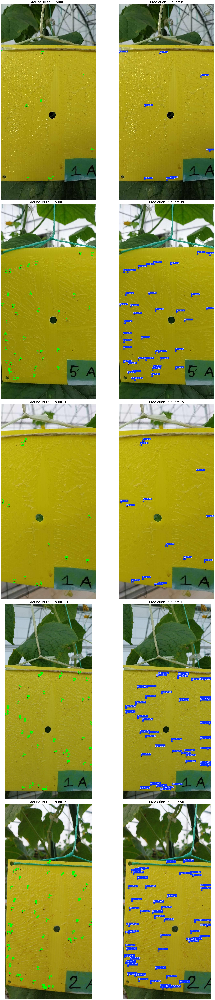

In [11]:
def count_gt(label_path):
    if not os.path.exists(label_path):
        return 0
    with open(label_path, 'r') as f:
        return len(f.readlines())


image_dir = '/kaggle/working/Insects-1/valid/images'
label_dir = '/kaggle/working/Insects-1/valid/labels'

show_n = 5
results = results[:show_n]

plt.figure(figsize=(40, 30 * show_n))

for i, r in enumerate(results):
    # Load original image
    img = cv2.imread(r.path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Ground Truth
    gt_img = img.copy()
    label_path = os.path.join(
        label_dir,
        os.path.splitext(os.path.basename(r.path))[0] + ".txt"
    )
    gt_img = draw_gt(gt_img, label_path)

    gt_count = count_gt(label_path)

    # Prediction
    pred_img = r.plot(
        labels=True,
        boxes=True,
        conf=True,
        line_width=2
    )
    pred_img = cv2.cvtColor(pred_img, cv2.COLOR_BGR2RGB)

    pred_count = len(r.boxes)

    # Plot GT
    plt.subplot(show_n, 2, 2*i + 1)
    plt.imshow(gt_img)
    plt.title(
        f"Ground Truth | Count: {gt_count}",
        fontsize=35
    )
    plt.axis("off")

    # Plot Prediction
    plt.subplot(show_n, 2, 2*i + 2)
    plt.imshow(pred_img)
    plt.title(
        f"Prediction | Count: {pred_count}",
        fontsize=35
    )
    plt.axis("off")

plt.tight_layout()
plt.show()


# Conclusion

In this project, a YOLO11s-based object detection model was applied to the task of black aphid detection on sticky traps under greenhouse conditions. At an input resolution of 1600 × 1600, the model achieved a precision of 0.862, a recall of 0.876, and an mAP@0.5 of 0.896, which are numerically comparable to, and in some cases slightly higher than, the best results reported in prior studies using YOLOv10-based architectures. The model also demonstrated a substantially faster inference time of approximately 0.018 s per image, indicating improved computational efficiency. Although direct comparisons are limited by differences in experimental setups, the results suggest that YOLO11s can provide competitive detection performance while offering practical advantages for real-time or near–real-time greenhouse pest monitoring.